# Bike Rental Prediction and Clustering Analysis

In this project, we aim to predict bike rentals and use clustering to find patterns in demand.

## Goals
- Predict bike rentals using weather, time, and holiday data.
- Use clustering to identify demand patterns.

## Datasets
- **hour.csv**: Hourly rental data
- **day.csv**: Daily rental data

Let's begin by loading and exploring the datasets.

In [1]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.metrics import r2_score, mean_absolute_error
from sklearn.preprocessing import StandardScaler
import matplotlib.pyplot as plt
import seaborn as sns



In [2]:
hourly_data = pd.read_csv('hour.csv')
daily_data = pd.read_csv('day.csv')
hourly_data.sample(10)

,instant,dteday,season,yr,mnth,hr,holiday,weekday,workingday,weathersit,temp,atemp,hum,windspeed,casual,registered,cnt
5017,5018,2011-08-01,3,0,8,23,0,1,1,1,0.68,0.6364,0.74,0.1940,14,82,96
17109,17110,2012-12-20,4,1,12,16,0,4,1,2,0.34,0.3030,0.53,0.3284,21,281,302
6582,6583,2011-10-06,4,0,10,20,0,4,1,1,0.50,0.4848,0.77,0.1045,29,231,260
5128,5129,2011-08-06,3,0,8,14,0,6,0,1,0.82,0.7727,0.52,0.2537,176,204,380
10583,10584,2012-03-22,2,1,3,2,0,4,1,1,0.52,0.5000,0.83,0.0896,1,5,6
10434,10435,2012-03-15,1,1,3,21,0,4,1,1,0.54,0.5152,0.68,0.2836,36,207,243
16771,16772,2012-12-06,4,1,12,14,0,4,1,1,0.30,0.3182,0.42,0.0896,37,175,212
14851,14852,2012-09-16,3,1,9,0,0,0,0,1,0.54,0.5152,0.64,0.0000,28,123,151
1920,1921,2011-03-25,2,0,3,19,0,5,1,2,0.30,0.2879,0.36,0.2836,9,126,135
11221,11222,2012-04-17,2,1,4,18,0,2,1,1,0.64,0.6061,0.25,0.2836,105,670,775


In [3]:
hourly_data.isnull().sum()

instant       0
dteday        0
season        0
yr            0
mnth          0
hr            0
holiday       0
weekday       0
workingday    0
weathersit    0
temp          0
atemp         0
hum           0
windspeed     0
casual        0
registered    0
cnt           0
dtype: int64

In [4]:
daily_data.isnull().sum()

instant       0
dteday        0
season        0
yr            0
mnth          0
holiday       0
weekday       0
workingday    0
weathersit    0
temp          0
atemp         0
hum           0
windspeed     0
casual        0
registered    0
cnt           0
dtype: int64

# pair plots for the 'hour.csv' dataset

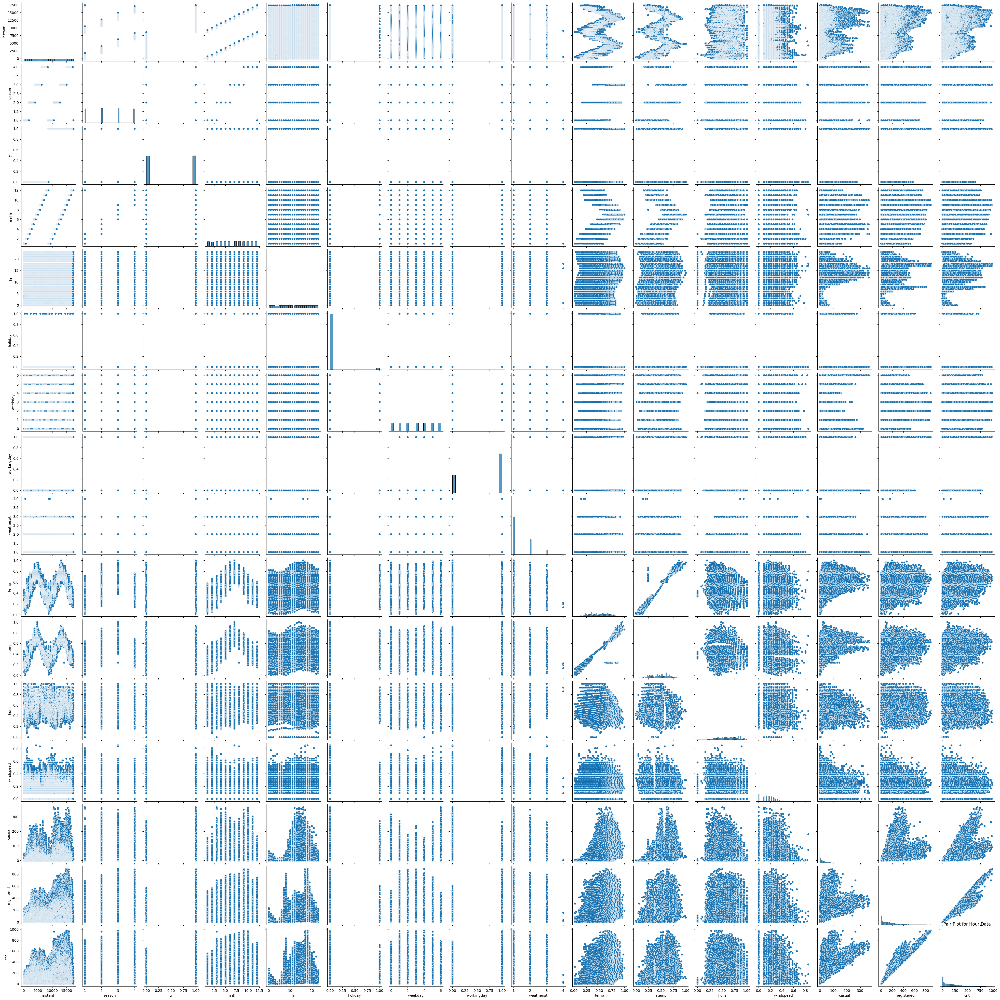

In [5]:

sns.pairplot(hourly_data)
plt.title("Pair Plot for Hour Data")
plt.show()

# Plot correlation heatmap for 'hour.csv' dataset

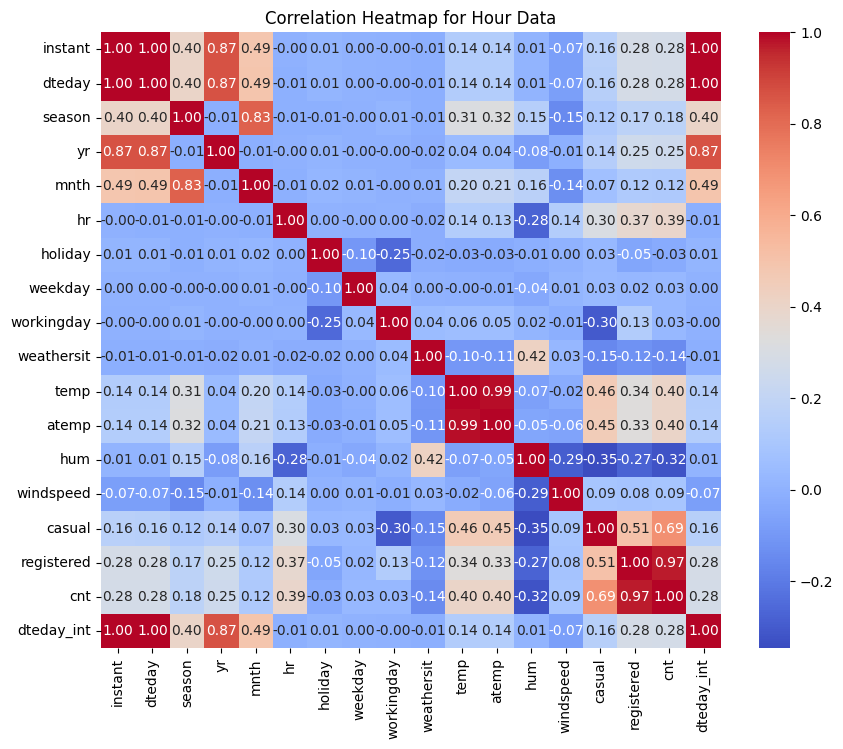

In [6]:

hourly_data['dteday'] = pd.to_datetime(hourly_data['dteday'])
hourly_data['dteday_int'] = hourly_data['dteday'].astype('int64') // 10**9
hour_corr = hourly_data.corr()
plt.figure(figsize=(10, 8))
sns.heatmap(hour_corr, annot=True, cmap='coolwarm', fmt='.2f')
plt.title("Correlation Heatmap for Hour Data")
plt.show()

In [7]:
hourly_data.head()

,instant,dteday,season,yr,mnth,hr,holiday,weekday,workingday,weathersit,temp,atemp,hum,windspeed,casual,registered,cnt,dteday_int
0,1,2011-01-01,1,0,1,0,0,6,0,1,0.24,0.2879,0.81,0.0,3,13,16,1293840000
1,2,2011-01-01,1,0,1,1,0,6,0,1,0.22,0.2727,0.80,0.0,8,32,40,1293840000
2,3,2011-01-01,1,0,1,2,0,6,0,1,0.22,0.2727,0.80,0.0,5,27,32,1293840000
3,4,2011-01-01,1,0,1,3,0,6,0,1,0.24,0.2879,0.75,0.0,3,10,13,1293840000
4,5,2011-01-01,1,0,1,4,0,6,0,1,0.24,0.2879,0.75,0.0,0,1,1,1293840000


# Part 1: Regression Model to Predict Hourly Bike Rentals 
# Data Preprocessing

In [8]:



# Converting categorical features to categories
hourly_data['season'] = hourly_data['season'].astype('category')
hourly_data['holiday'] = hourly_data['holiday'].astype('category')
hourly_data['workingday'] = hourly_data['workingday'].astype('category')
hourly_data['weathersit'] = hourly_data['weathersit'].astype('category')

#Extract features and target variable
features = hourly_data[['season', 'holiday', 'workingday', 'weathersit', 'temp', 'windspeed', 'hr','yr','mnth','casual','registered']]
target = hourly_data['cnt']

features = pd.get_dummies(features, drop_first=True) # k-1 One-hot encoding for categorical features
features

,temp,windspeed,hr,yr,mnth,casual,registered,season_2,season_3,season_4,holiday_1,workingday_1,weathersit_2,weathersit_3,weathersit_4
0,0.24,0.0000,0,0,1,3,13,False,False,False,False,False,False,False,False
1,0.22,0.0000,1,0,1,8,32,False,False,False,False,False,False,False,False
2,0.22,0.0000,2,0,1,5,27,False,False,False,False,False,False,False,False
3,0.24,0.0000,3,0,1,3,10,False,False,False,False,False,False,False,False
4,0.24,0.0000,4,0,1,0,1,False,False,False,False,False,False,False,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
17374,0.26,0.1642,19,1,12,11,108,False,False,False,False,True,True,False,False
17375,0.26,0.1642,20,1,12,8,81,False,False,False,False,True,True,False,False
17376,0.26,0.1642,21,1,12,7,83,False,False,False,False,True,False,False,False
17377,0.26,0.1343,22,1,12,13,48,False,False,False,False,True,False,False,False


Text(0.5, 1.0, 'Pair Plot for Hour Data')

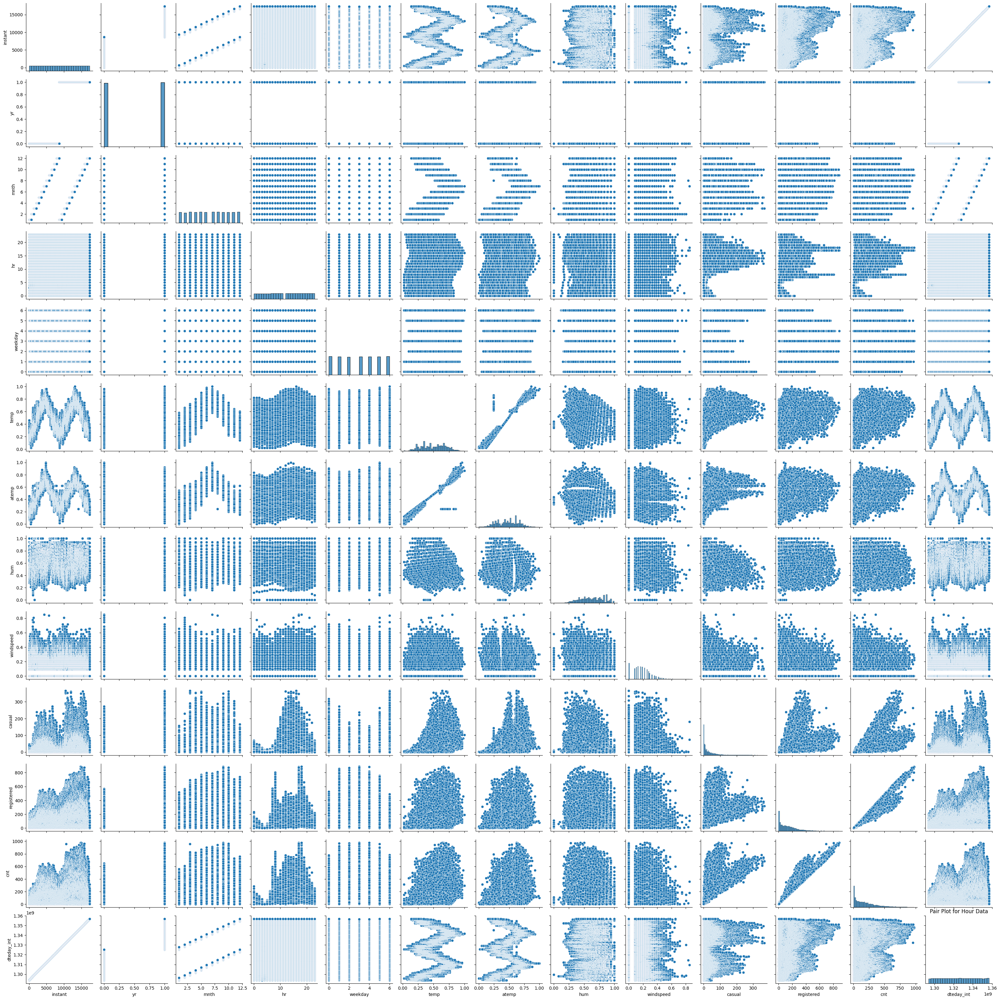

In [9]:
sns.pairplot(hourly_data)
plt.title("Pair Plot for Hour Data")
# plt.show()

In [10]:
from sklearn.preprocessing import StandardScaler
import pandas as pd

scaler = StandardScaler()

scaled_features = pd.DataFrame(scaler.fit_transform(features), columns=features.columns)

hourly_data = pd.concat([scaled_features, target.reset_index(drop=True)], axis=1)

hourly_data.head()

,temp,windspeed,hr,yr,mnth,casual,registered,season_2,season_3,season_4,holiday_1,workingday_1,weathersit_2,weathersit_3,weathersit_4,cnt
0,-1.334648,-1.553889,-1.670004,-1.005134,-1.610438,-0.662755,-0.930189,-0.583042,-0.590751,-0.567361,-0.172112,-1.4669,-0.595006,-0.298177,-0.01314,16
1,-1.438516,-1.553889,-1.525374,-1.005134,-1.610438,-0.561343,-0.804655,-0.583042,-0.590751,-0.567361,-0.172112,-1.4669,-0.595006,-0.298177,-0.01314,40
2,-1.438516,-1.553889,-1.380744,-1.005134,-1.610438,-0.622190,-0.837690,-0.583042,-0.590751,-0.567361,-0.172112,-1.4669,-0.595006,-0.298177,-0.01314,32
3,-1.334648,-1.553889,-1.236115,-1.005134,-1.610438,-0.662755,-0.950010,-0.583042,-0.590751,-0.567361,-0.172112,-1.4669,-0.595006,-0.298177,-0.01314,13
4,-1.334648,-1.553889,-1.091485,-1.005134,-1.610438,-0.723603,-1.009474,-0.583042,-0.590751,-0.567361,-0.172112,-1.4669,-0.595006,-0.298177,-0.01314,1


 # After scalling the data

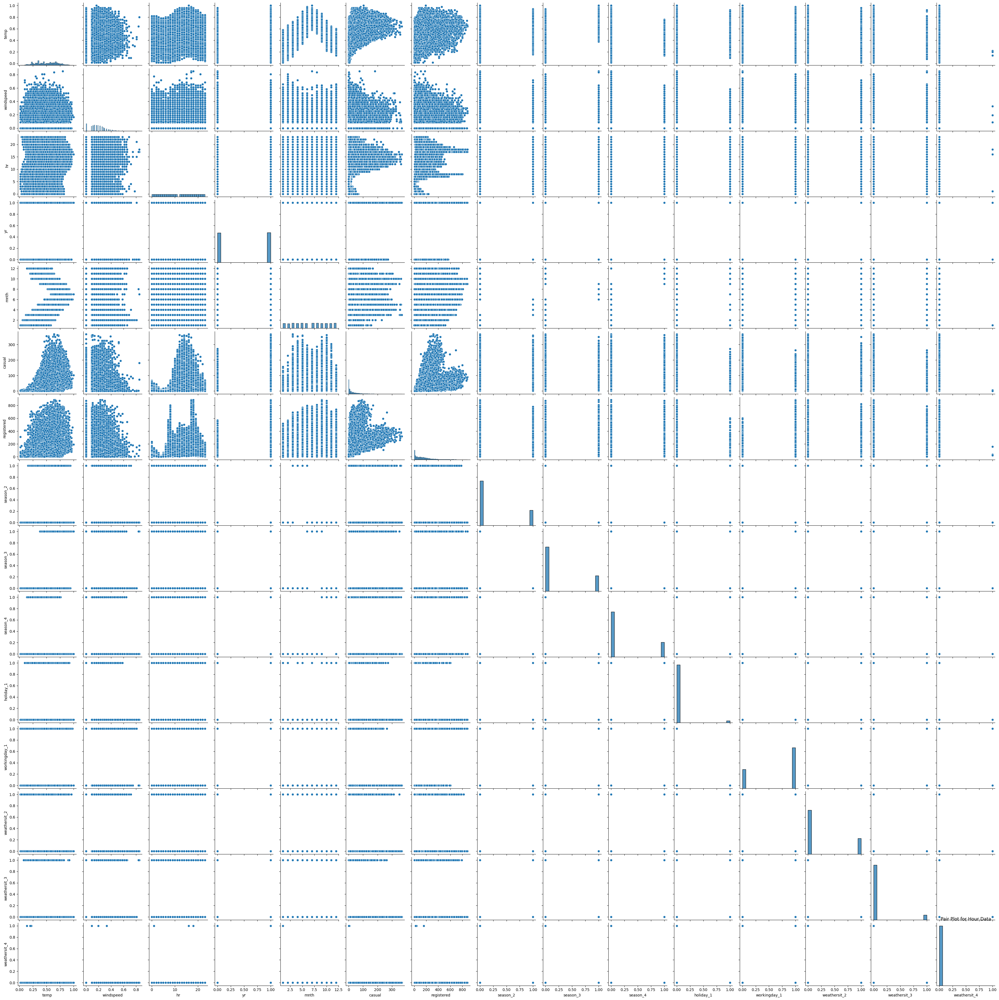

In [11]:
sns.pairplot(features)
plt.title("Pair Plot for Hour Data")
plt.show()

 # Applying the Random forest 

In [12]:
# spliting the data 
from collections import Counter
from sklearn.model_selection import train_test_split
from joblib import Parallel, delayed

class DecisionTree:
    def __init__(self, max_depth=None, min_samples_split=2):
        self.max_depth = max_depth
        self.min_samples_split = min_samples_split
        self.tree = None

    def _best_split(self, X, y):
        best_idx, best_thr = None, None
        best_gini = 1.0

        for idx in range(X.shape[1]):
            thresholds = np.unique(X[:, idx])
            for thr in thresholds:
                left_idxs = X[:, idx] <= thr
                right_idxs = X[:, idx] > thr

                if len(y[left_idxs]) < self.min_samples_split or len(y[right_idxs]) < self.min_samples_split:
                    continue

                gini = self._gini_impurity(y[left_idxs], y[right_idxs])
                if gini < best_gini:
                    best_gini = gini
                    best_idx = idx
                    best_thr = thr

        return best_idx, best_thr

    def _gini_impurity(self, y_left, y_right):
        n_left = len(y_left)
        n_right = len(y_right)
        n_total = n_left + n_right

        gini_left = 1.0 - sum([(count / n_left) ** 2 for count in Counter(y_left).values()]) if n_left > 0 else 0
        gini_right = 1.0 - sum([(count / n_right) ** 2 for count in Counter(y_right).values()]) if n_right > 0 else 0

        return (n_left / n_total) * gini_left + (n_right / n_total) * gini_right

    def _build_tree(self, X, y, depth=0):
        if depth >= self.max_depth or len(np.unique(y)) == 1 or len(y) < self.min_samples_split:
            return np.mean(y) 

        best_idx, best_thr = self._best_split(X, y)
        if best_idx is None:
            return np.mean(y)

        left_idxs = X[:, best_idx] <= best_thr
        right_idxs = X[:, best_idx] > best_thr

        left_tree = self._build_tree(X[left_idxs], y[left_idxs], depth + 1)
        right_tree = self._build_tree(X[right_idxs], y[right_idxs], depth + 1)

        return {'feature_idx': best_idx, 'threshold': best_thr, 'left': left_tree, 'right': right_tree}

    def fit(self, X, y):
        self.tree = self._build_tree(X, y)

    def predict(self, X):
        def _predict_row(row, tree):
            if isinstance(tree, (int, float)): 
                return tree
            if row[tree['feature_idx']] <= tree['threshold']:
                return _predict_row(row, tree['left'])
            else:
                return _predict_row(row, tree['right'])

        return np.array([_predict_row(row, self.tree) for row in X])


class RandomForest:
    def __init__(self, n_estimators=50, max_depth=10, min_samples_split=2, max_features='sqrt', random_state=None):
        self.n_estimators = n_estimators
        self.max_depth = max_depth
        self.min_samples_split = min_samples_split
        self.max_features = max_features
        self.random_state = random_state
        self.trees = []

    def _bootstrap_sample(self, X, y):
        n_samples = X.shape[0]
        idxs = np.random.choice(n_samples, n_samples, replace=True)
        return X.iloc[idxs], y.iloc[idxs]

    def _fit_tree(self, X_sample, y_sample, feature_idxs):
        tree = DecisionTree(max_depth=self.max_depth, min_samples_split=self.min_samples_split)
        tree.fit(X_sample.values[:, feature_idxs], y_sample.values)
        return tree

    def fit(self, X, y):
        np.random.seed(self.random_state)
        self.trees = []
        num_features = int(np.sqrt(X.shape[1])) if self.max_features == 'sqrt' else self.max_features
        
        for _ in range(self.n_estimators):
            X_sample, y_sample = self._bootstrap_sample(X, y)
            feature_idxs = np.random.choice(X.shape[1], num_features, replace=False)
            
            tree = self._fit_tree(X_sample, y_sample, feature_idxs)
            self.trees.append((tree, feature_idxs))

    def predict(self, X):
        tree_predictions = Parallel(n_jobs=-1)(delayed(tree.predict)(X.values[:, feature_idxs]) for tree, feature_idxs in self.trees)
        return np.mean(tree_predictions, axis=0)








In [13]:
# Assuming features and target are defined
X_train, X_test, y_train, y_test = train_test_split(features, target, test_size=0.1, random_state=42)

model = RandomForest(n_estimators=50, random_state=42)  # Reduced the number of estimators
model.fit(X_train, y_train)

#  Evaluating the model

In [14]:


from sklearn.metrics import accuracy_score
y_pred = model.predict(X_test)
r2 = r2_score(y_test, y_pred)

mae = mean_absolute_error(y_test, y_pred)
print(f"R² score: {r2:.2f}")
print(f"Mean Absolute Error: {mae:.2f}")
y_pred = model.predict(X_test)







R² score: 0.67
Mean Absolute Error: 75.32


 # Analysis on Daily Data


# pair plots for the 'day.csv' dataset

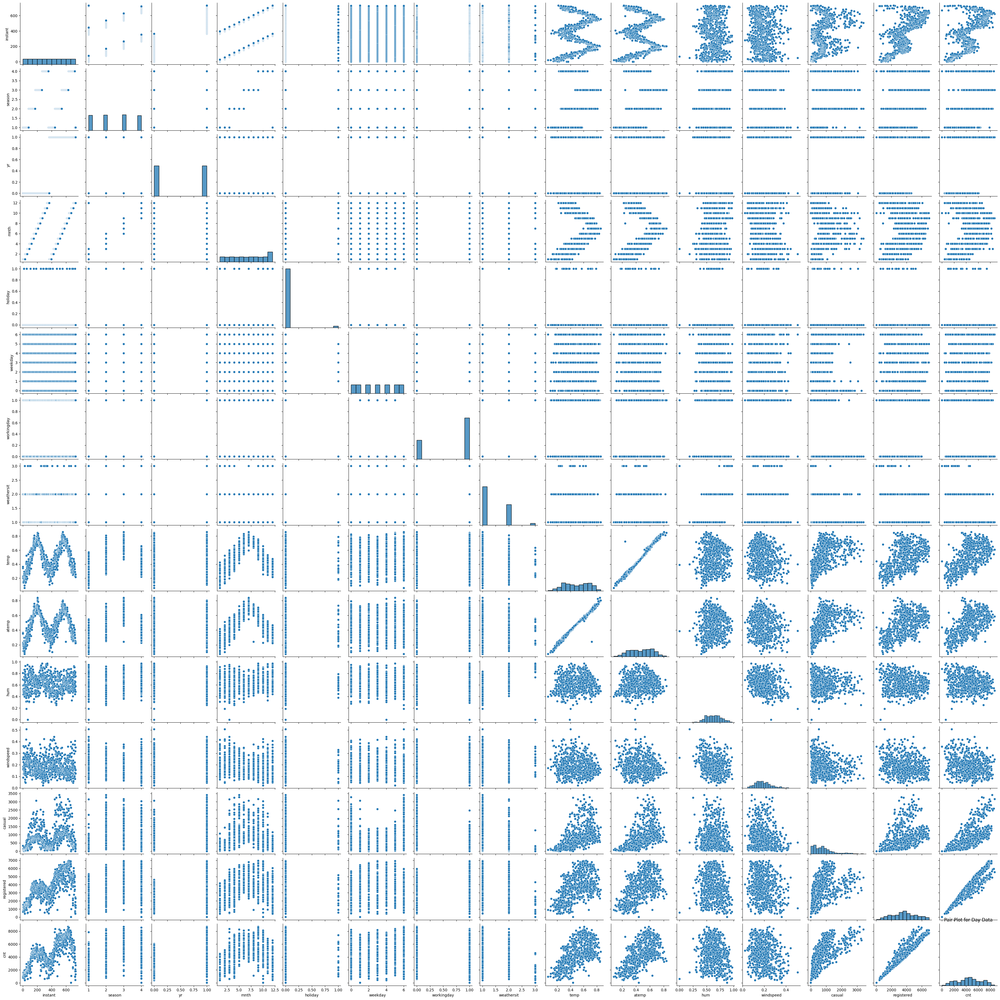

In [15]:


sns.pairplot(daily_data)
plt.title("Pair Plot for Day Data")
plt.show()

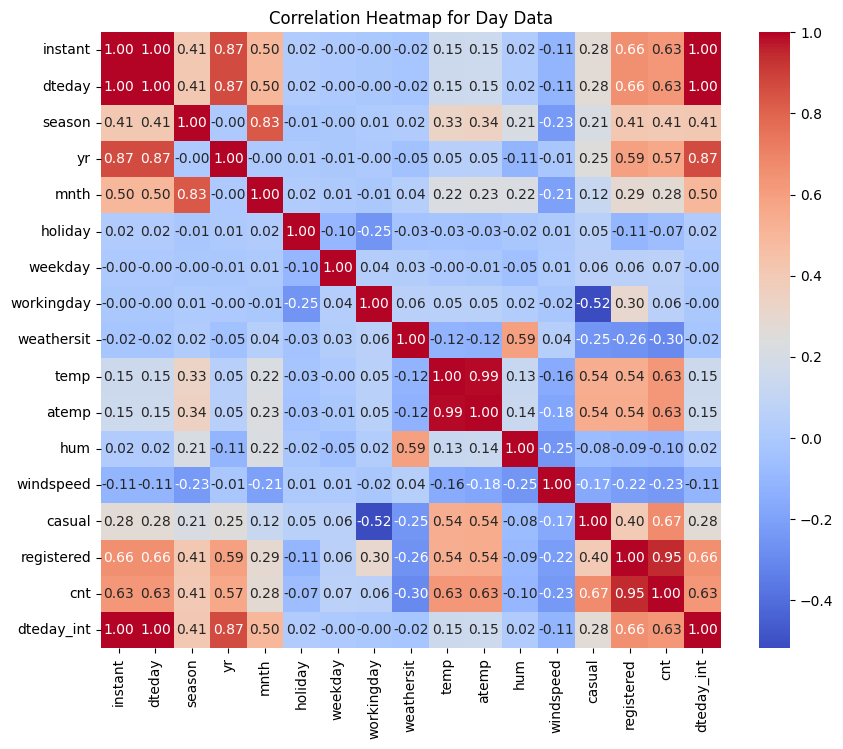

In [16]:
# Convert 'dteday' column to datetime
daily_data['dteday'] = pd.to_datetime(daily_data['dteday'])

#  Convert 'dteday' to an integer (if you want to include it in the correlation)
daily_data['dteday_int'] = daily_data['dteday'].astype('int64') 

#  Compute correlation matrices of daily data
day_corr = daily_data.corr()

# Plot correlation heatmap for 'day.csv' dataset
plt.figure(figsize=(10, 8))
sns.heatmap(day_corr, annot=True, cmap='coolwarm', fmt='.2f')
plt.title("Correlation Heatmap for Day Data")
plt.show()

# Part 2: Clustering Analysis on Daily Bike Rentals

In [17]:

class KMeans:
    def __init__(self, n_clusters=3, max_iter=300, tol=1e-4, random_state=None):
       
        self.n_clusters = n_clusters
        self.max_iter = max_iter
        self.tol = tol
        self.random_state = random_state
        self.centroids = None
        self.labels_ = None
        self.inertia_ = None  # Initialize inertia

    def fit(self, X):
       
       
        if self.random_state is not None:
            np.random.seed(self.random_state)
        
        initial_indices = np.random.choice(X.shape[0], self.n_clusters, replace=False)
        self.centroids = X[initial_indices]

        for _ in range(self.max_iter):
            self.labels_ = self._assign_clusters(X)
            new_centroids = self._update_centroids(X)
            if np.all(np.abs(new_centroids - self.centroids) < self.tol):
                break

            self.centroids = new_centroids

        self.inertia_ = self._calculate_inertia(X)

    def _assign_clusters(self, X):
       
        distances = np.linalg.norm(X[:, np.newaxis] - self.centroids, axis=2)
        return np.argmin(distances, axis=1)

    def _update_centroids(self, X):
       
        new_centroids = np.zeros((self.n_clusters, X.shape[1]))
        for k in range(self.n_clusters):
            cluster_points = X[self.labels_ == k]
            if len(cluster_points) > 0:
                new_centroids[k] = cluster_points.mean(axis=0)
        return new_centroids

    def _calculate_inertia(self, X):
       
        distances = np.linalg.norm(X - self.centroids[self.labels_], axis=1)
        return np.sum(distances ** 2)

    def predict(self, X):
       
        return self._assign_clusters(X)

    def fit_predict(self, X):
       
        self.fit(X)
        return self.labels_


In [18]:
# Selecting relevant features for clustering
daily_features = daily_data[['season', 'holiday', 'workingday', 'temp', 'windspeed']]

 # Scaling the features
scaler = StandardScaler()
daily_features_scaled = scaler.fit_transform(daily_features)



# Using the Elbow Method to find the optimal number of clusters

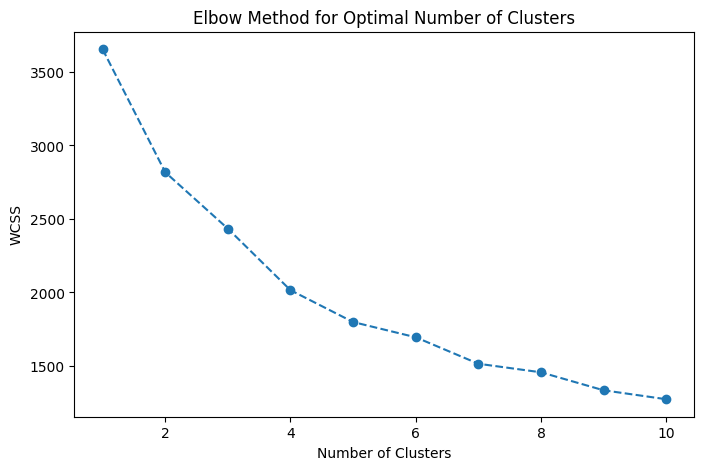

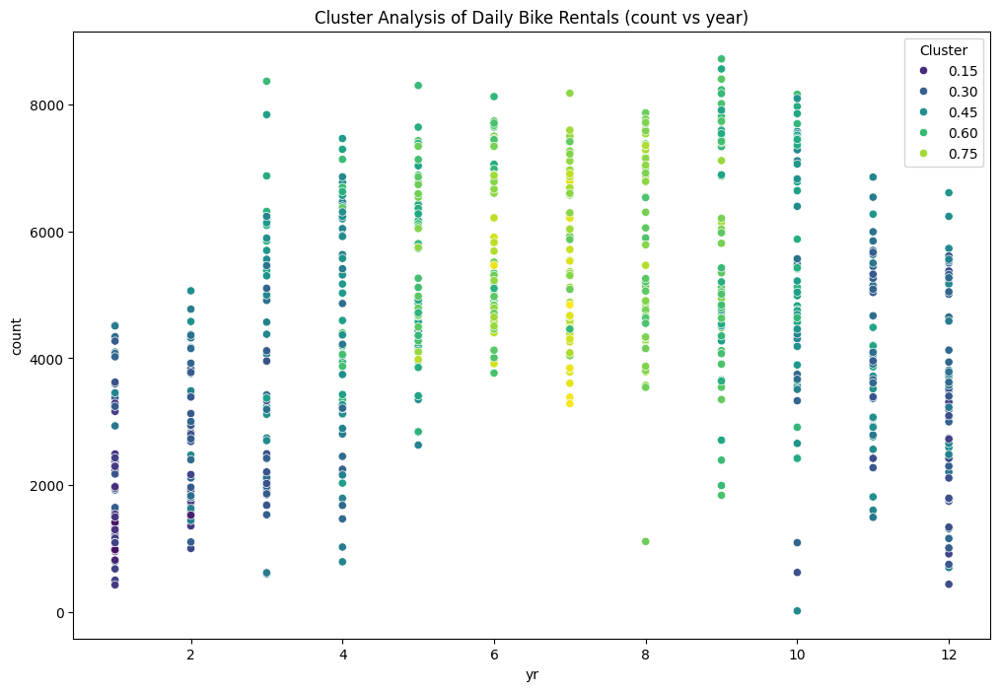

Average Bike Rentals per Cluster:
Cluster
0    4997.707547
1    2546.183824
2    4310.731343
3    5305.888889
4    3491.795918
5    5627.231884
Name: cnt, dtype: float64

Cluster 0 Summary:
          instant                         dteday  season          yr  \
count  106.000000                            106   106.0  106.000000   
mean   491.773585  2012-05-05 18:33:57.735848960     4.0    0.500000   
min    266.000000            2011-09-23 00:00:00     4.0    0.000000   
25%    305.250000            2011-11-01 06:00:00     4.0    0.000000   
50%    493.500000            2012-05-07 12:00:00     4.0    0.500000   
75%    679.000000            2012-11-09 00:00:00     4.0    1.000000   
max    720.000000            2012-12-20 00:00:00     4.0    1.000000   
std    188.660707                            NaN     0.0    0.502375   

             mnth  holiday     weekday  workingday  weathersit        temp  \
count  106.000000    106.0  106.000000  106.000000  106.000000  106.000000   
mean 

In [19]:

wcss = []
for i in range(1, 11):
    kmeans = KMeans(n_clusters=i, random_state=42)
    kmeans.fit(daily_features_scaled)
    
    wcss.append(kmeans.inertia_)
           # Plot the Elbow Curve
plt.figure(figsize=(8, 5))
plt.plot(range(1, 11), wcss, marker='o', linestyle='--')
plt.title('Elbow Method for Optimal Number of Clusters')
plt.xlabel('Number of Clusters')
plt.ylabel('WCSS')
plt.show()

# Choose the optimal number of clusters based on the Elbow Method (assume k=4 here)
optimal_clusters = 6

kmeans = KMeans(n_clusters=optimal_clusters, random_state=42)
daily_data['Cluster'] = kmeans.fit_predict(daily_features_scaled)

# # Visualizing Clusters (count vs. temp)
plt.figure(figsize=(12, 8))
sns.scatterplot(x=daily_data['mnth'], y=daily_data['cnt'], hue=daily_data['temp'], palette='viridis')
plt.title("Cluster Analysis of Daily Bike Rentals (count vs year)")
plt.xlabel("yr")
plt.ylabel("count")
plt.legend(title="Cluster")
plt.show()

# Analyzing the characteristics of each cluster
print("Average Bike Rentals per Cluster:")
print(daily_data.groupby('Cluster')['cnt'].mean())

# Optional: Analyzing the distribution of features within each cluster
for i in range(optimal_clusters):
    print(f"\nCluster {i} Summary:")
    print(daily_data[daily_data['Cluster'] == i].describe())


In [20]:

import plotly.express as px
fig = px.scatter_3d(
    daily_data,
                    x='temp',
                    y='hum',
                    z='windspeed',
                    color='Cluster',  # Color by cluster
                    title='3D Scatter Plot of Clusters',
                    labels={'temp': 'Temperature',
                            'hum': 'Humidity',
                            'windspeed': 'Windspeed'},
                    color_continuous_scale=px.colors.sequential.Viridis)

# Show the plot
fig.show()

c:\Users\Ramji\AppData\Local\Programs\Python\Python312\Lib\site-packages\seaborn\axisgrid.py:1513: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.

c:\Users\Ramji\AppData\Local\Programs\Python\Python312\Lib\site-packages\seaborn\axisgrid.py:1513: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.

c:\Users\Ramji\AppData\Local\Programs\Python\Python312\Lib\site-packages\seaborn\axisgrid.py:1513: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.

c:\Users\Ramji\AppData\Local\Programs\Python\Python312\Lib\site-packages\seaborn\axisgrid.py:1513: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.

c:\Users\Ramji\AppData\Local\Programs\Python\Python312\Lib\site-packages\seaborn\axisgrid.py:1513: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.

c:\Users\Ramji\AppData\Local\Programs\Python\Python312\Lib\site-packages\seaborn\axisgrid.py:1513: UserWarning

<Figure size 1200x800 with 0 Axes>

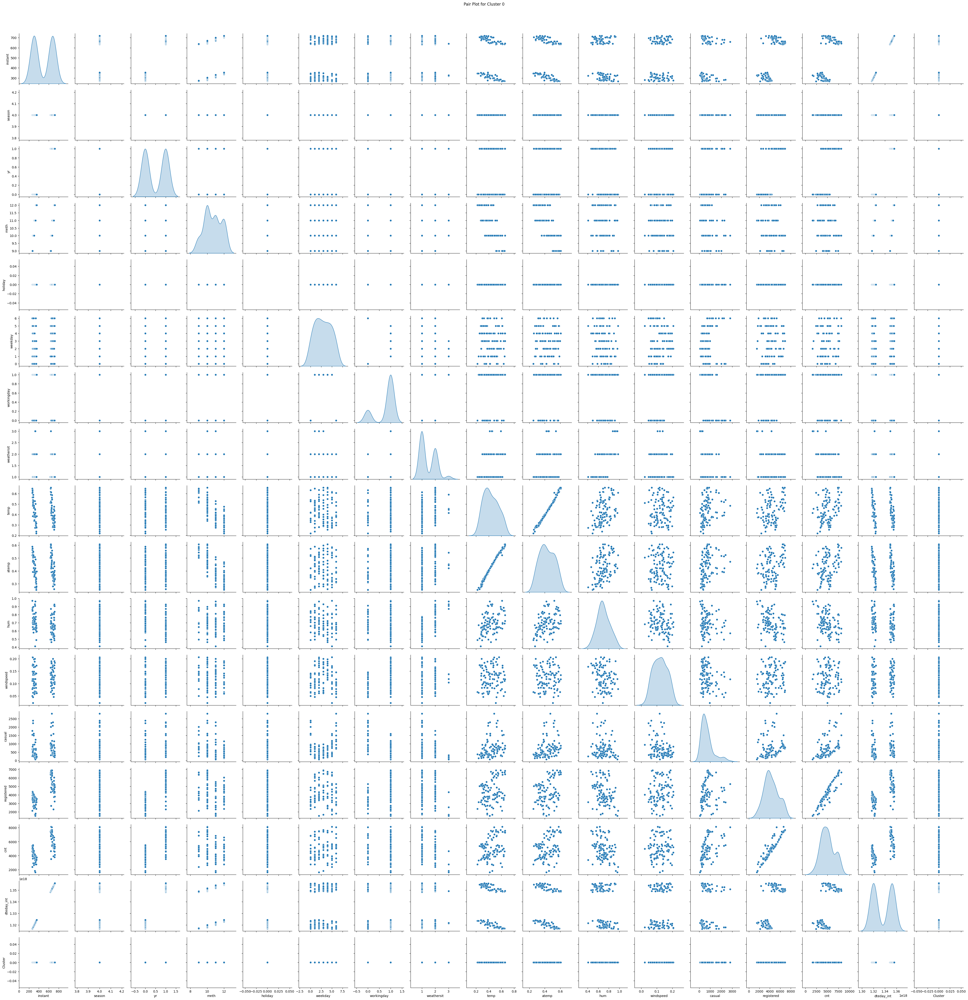

c:\Users\Ramji\AppData\Local\Programs\Python\Python312\Lib\site-packages\seaborn\axisgrid.py:1513: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.

c:\Users\Ramji\AppData\Local\Programs\Python\Python312\Lib\site-packages\seaborn\axisgrid.py:1513: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.

c:\Users\Ramji\AppData\Local\Programs\Python\Python312\Lib\site-packages\seaborn\axisgrid.py:1513: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.

c:\Users\Ramji\AppData\Local\Programs\Python\Python312\Lib\site-packages\seaborn\axisgrid.py:1513: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.

c:\Users\Ramji\AppData\Local\Programs\Python\Python312\Lib\site-packages\seaborn\axisgrid.py:1513: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.

c:\Users\Ramji\AppData\Local\Programs\Python\Python312\Lib\site-packages\seaborn\axisgrid.py:1513: UserWarning

<Figure size 1200x800 with 0 Axes>

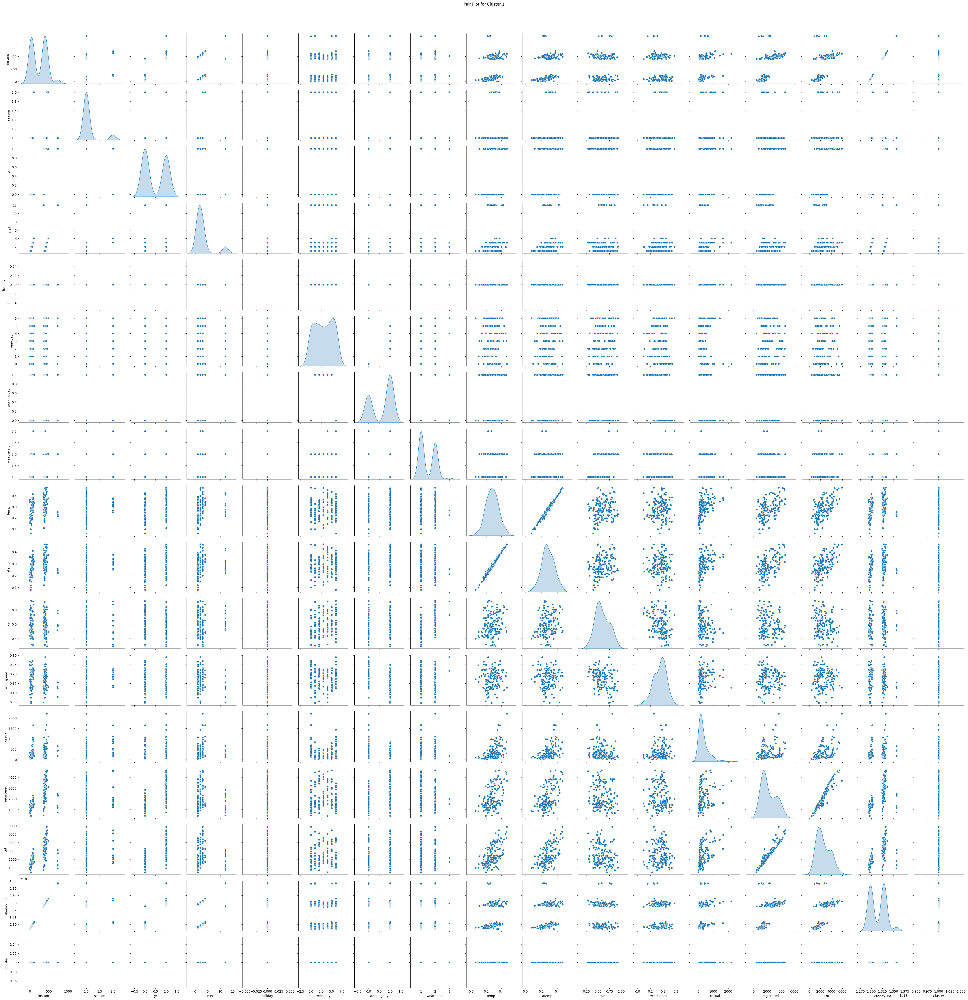

c:\Users\Ramji\AppData\Local\Programs\Python\Python312\Lib\site-packages\seaborn\axisgrid.py:1513: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.

c:\Users\Ramji\AppData\Local\Programs\Python\Python312\Lib\site-packages\seaborn\axisgrid.py:1513: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.

c:\Users\Ramji\AppData\Local\Programs\Python\Python312\Lib\site-packages\seaborn\axisgrid.py:1513: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.

c:\Users\Ramji\AppData\Local\Programs\Python\Python312\Lib\site-packages\seaborn\axisgrid.py:1513: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.

c:\Users\Ramji\AppData\Local\Programs\Python\Python312\Lib\site-packages\seaborn\axisgrid.py:1513: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.

c:\Users\Ramji\AppData\Local\Programs\Python\Python312\Lib\site-packages\seaborn\axisgrid.py:1513: UserWarning

<Figure size 1200x800 with 0 Axes>

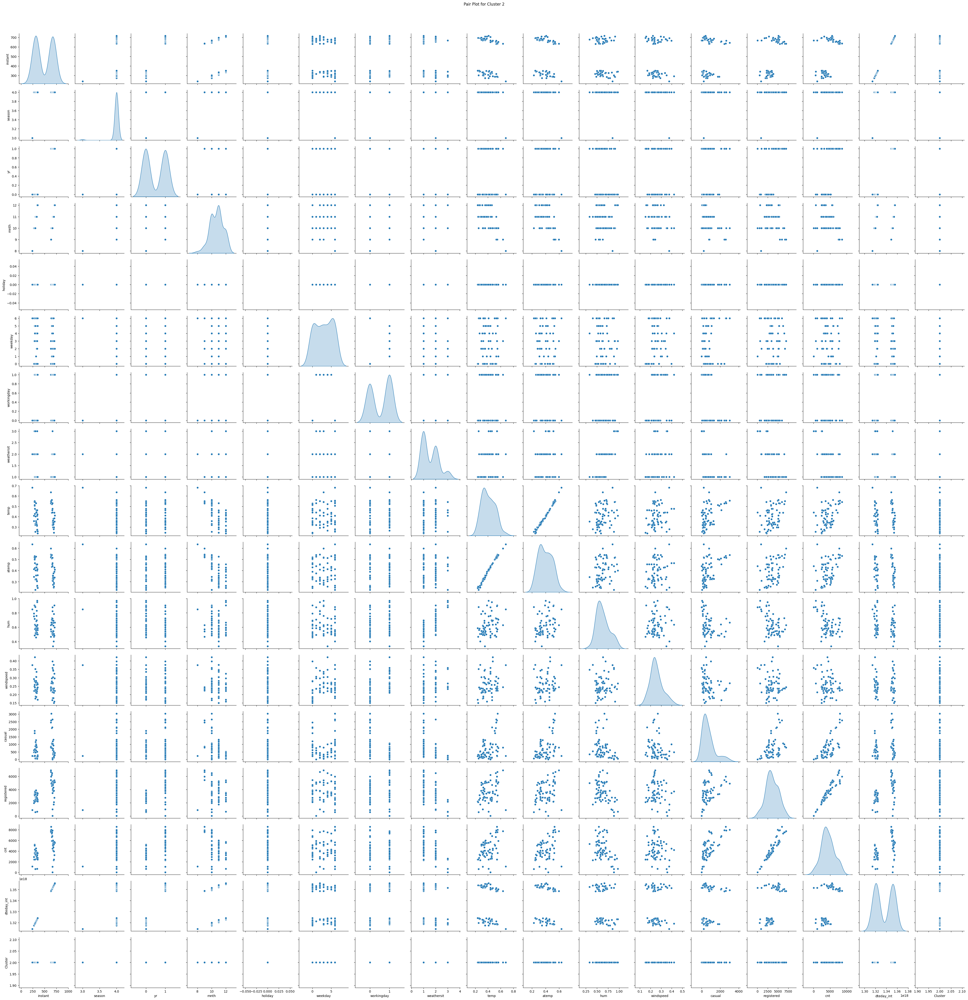

c:\Users\Ramji\AppData\Local\Programs\Python\Python312\Lib\site-packages\seaborn\axisgrid.py:1513: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.

c:\Users\Ramji\AppData\Local\Programs\Python\Python312\Lib\site-packages\seaborn\axisgrid.py:1513: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.

c:\Users\Ramji\AppData\Local\Programs\Python\Python312\Lib\site-packages\seaborn\axisgrid.py:1513: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.

c:\Users\Ramji\AppData\Local\Programs\Python\Python312\Lib\site-packages\seaborn\axisgrid.py:1513: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.

c:\Users\Ramji\AppData\Local\Programs\Python\Python312\Lib\site-packages\seaborn\axisgrid.py:1513: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.

c:\Users\Ramji\AppData\Local\Programs\Python\Python312\Lib\site-packages\seaborn\axisgrid.py:1513: UserWarning

<Figure size 1200x800 with 0 Axes>

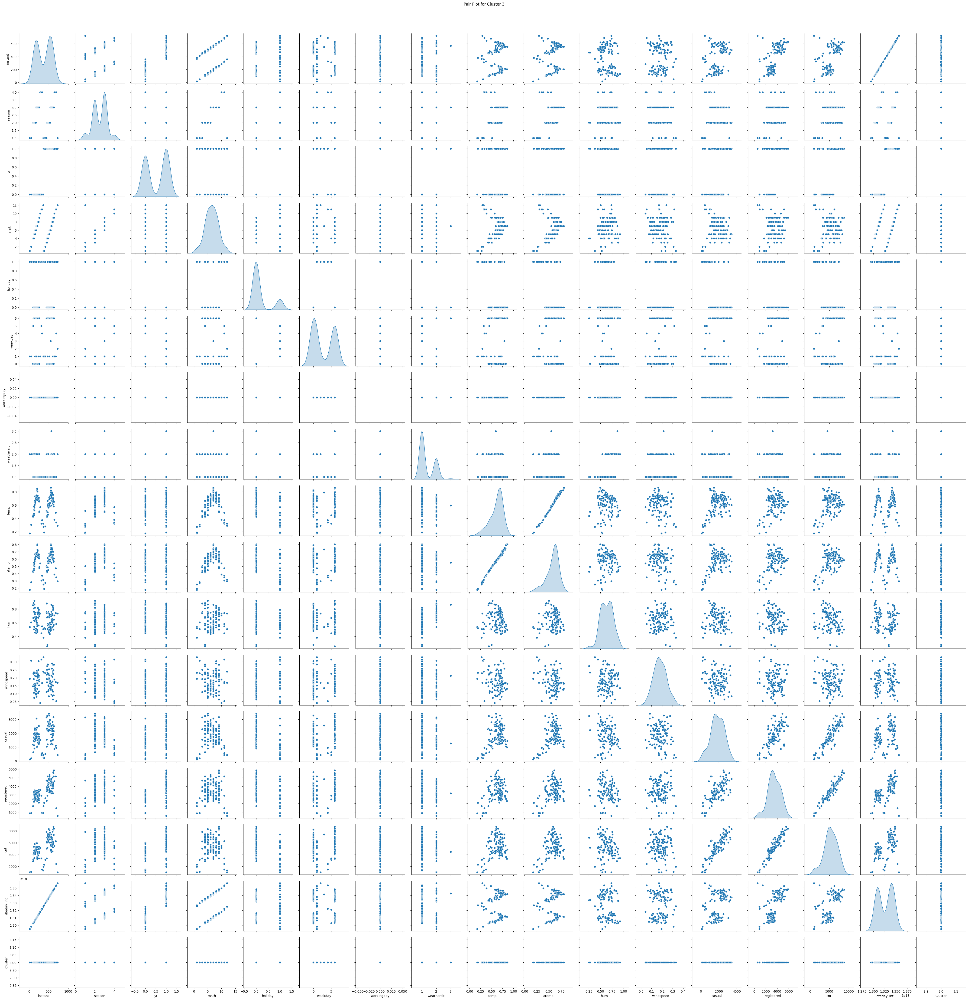

c:\Users\Ramji\AppData\Local\Programs\Python\Python312\Lib\site-packages\seaborn\axisgrid.py:1513: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.

c:\Users\Ramji\AppData\Local\Programs\Python\Python312\Lib\site-packages\seaborn\axisgrid.py:1513: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.

c:\Users\Ramji\AppData\Local\Programs\Python\Python312\Lib\site-packages\seaborn\axisgrid.py:1513: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.

c:\Users\Ramji\AppData\Local\Programs\Python\Python312\Lib\site-packages\seaborn\axisgrid.py:1513: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.

c:\Users\Ramji\AppData\Local\Programs\Python\Python312\Lib\site-packages\seaborn\axisgrid.py:1513: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.

c:\Users\Ramji\AppData\Local\Programs\Python\Python312\Lib\site-packages\seaborn\axisgrid.py:1513: UserWarning

<Figure size 1200x800 with 0 Axes>

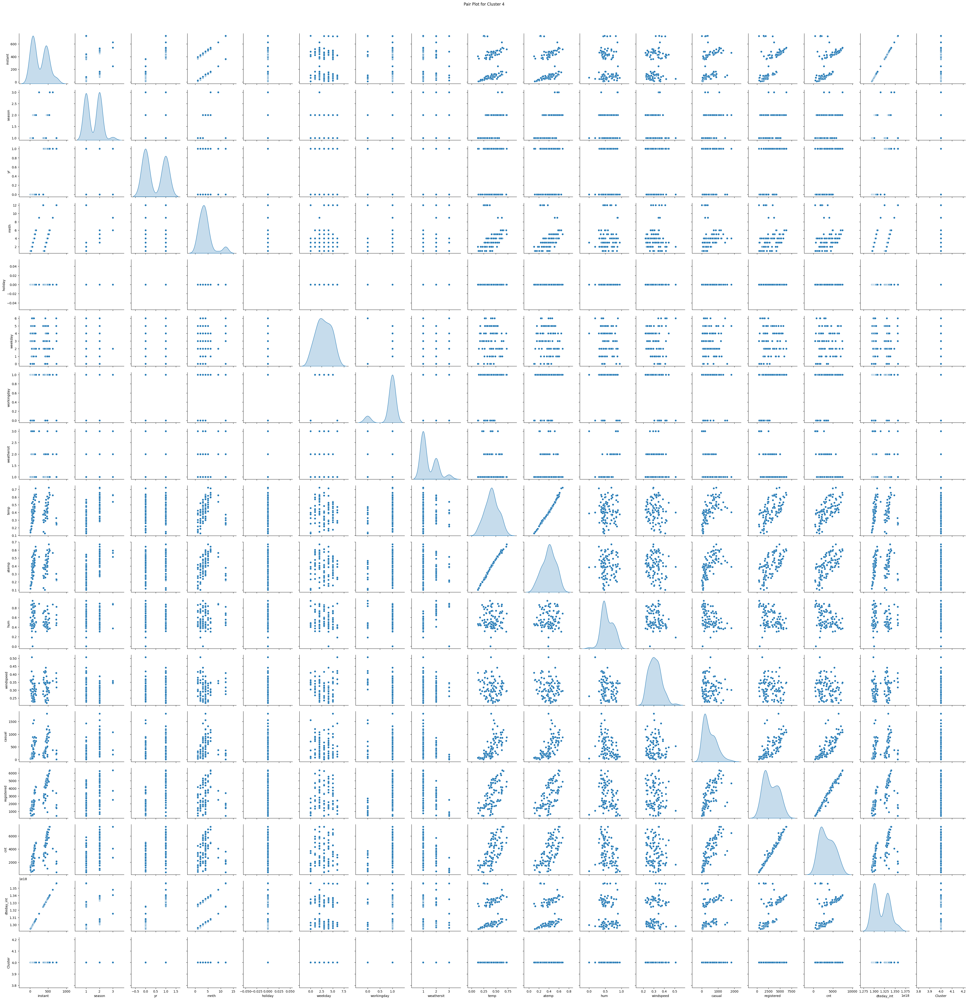

c:\Users\Ramji\AppData\Local\Programs\Python\Python312\Lib\site-packages\seaborn\axisgrid.py:1513: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.

c:\Users\Ramji\AppData\Local\Programs\Python\Python312\Lib\site-packages\seaborn\axisgrid.py:1513: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.

c:\Users\Ramji\AppData\Local\Programs\Python\Python312\Lib\site-packages\seaborn\axisgrid.py:1513: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.

c:\Users\Ramji\AppData\Local\Programs\Python\Python312\Lib\site-packages\seaborn\axisgrid.py:1513: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.

c:\Users\Ramji\AppData\Local\Programs\Python\Python312\Lib\site-packages\seaborn\axisgrid.py:1513: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.

c:\Users\Ramji\AppData\Local\Programs\Python\Python312\Lib\site-packages\seaborn\axisgrid.py:1513: UserWarning

<Figure size 1200x800 with 0 Axes>

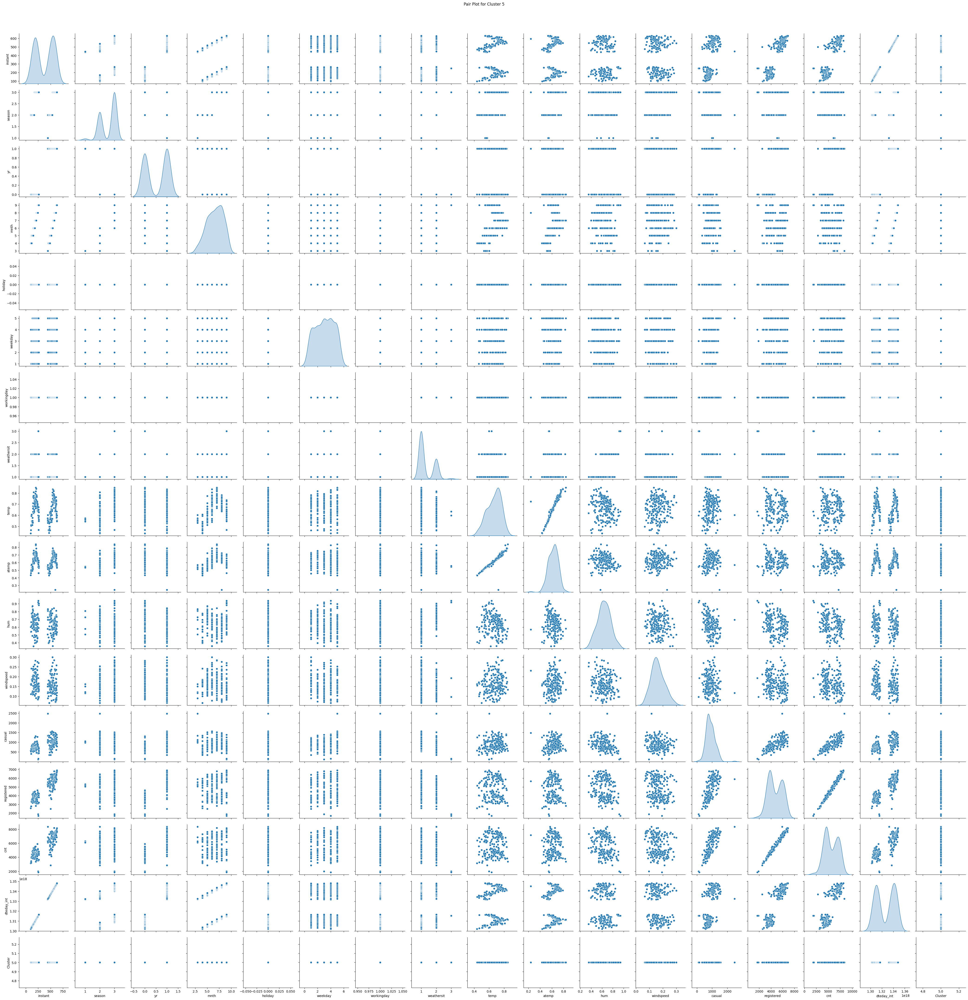

In [21]:


optimal_clusters = 6  # Set to the number of clusters you determined earlier

# Loop through each cluster and create a pair plot
for cluster in range(optimal_clusters):
    cluster_data = daily_data[daily_data['Cluster'] == cluster]
    
    plt.figure(figsize=(12, 8))
    sns.pairplot(cluster_data, diag_kind='kde', markers='o', palette='viridis')
    
    plt.suptitle(f"Pair Plot for Cluster {cluster}", y=1.02)  #Adjust title position
    plt.show()
